
<h1 id="Analysis-of-airport-network-of-USA-and-the-spread-of-covid19-due-to-movement-of-passengers-from-one-state-to-another-state-by-flights-movement"><font color="blue">Analysis of airport network of USA and the spread of covid19 due to movement of passengers from one state to another state by flights movement</font><a class="anchor-link" href="#Analysis-of-airport-network-of-USA-and-the-spread-of-covid19-due-to-movement-of-passengers-from-one-state-to-another-state-by-flights-movement">¶</a></h1>


In [1]:
import os
os.environ['PROJ_LIB'] = '/home/anuj/anaconda3/pkgs/proj4-5.2.0-he6710b0_1/share/proj'
import pandas as pd
import networkx as nx
import matplotlib.pyplot as plt
from mpl_toolkits.basemap import Basemap as Basemap
import collections
import numpy as np
from random import *
import math


<h3 id="Analysis-of-airport-network-of-USA">Analysis of airport network of USA<a class="anchor-link" href="#Analysis-of-airport-network-of-USA">¶</a></h3>


In [2]:

fields = ['Origin_airport', 'Destination_airport','Flights']
df = pd.read_csv('data/AirportsModified.csv',skipinitialspace=True, usecols=fields)

org = df.Origin_airport
dest = df.Destination_airport
noOfFlights = df.Flights



In [3]:

# setting up terrain of USA using BaseMap

m = Basemap(projection='merc',llcrnrlon=-180,llcrnrlat=10,urcrnrlon=-50,
urcrnrlat=70, lat_ts=0, resolution='c',suppress_ticks=True)



/home/anuj/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:4: MatplotlibDeprecationWarning: 
The dedent function was deprecated in Matplotlib 3.1 and will be removed in 3.3. Use inspect.cleandoc instead.
  after removing the cwd from sys.path.


In [4]:

locations = pd.read_csv('data/LocationsModified.csv', 
            skipinitialspace=True, 
            usecols=['Address','Latitude','Longitude'])



In [5]:

# setting up the latitude and longitudes of the airports to the USA terrain

mx, my = m(locations['Longitude'].values, locations['Latitude'].values)
pos = {}
for count, elem in enumerate (locations['Address']):
     pos[elem] = (mx[count], my[count])




<h4 id="Visualisation-of-airport-network-at-USA-terrain-using-longitude-and-latitude-data-of-airports">Visualisation of airport network at USA terrain using longitude and latitude data of airports<a class="anchor-link" href="#Visualisation-of-airport-network-at-USA-terrain-using-longitude-and-latitude-data-of-airports">¶</a></h4><h4 id="Orange-color-nodes-are-airports-which-are-busy(or-heavy-traffic)"><font color="orange">Orange</font> color nodes are airports which are busy(or heavy traffic)<a class="anchor-link" href="#Orange-color-nodes-are-airports-which-are-busy(or-heavy-traffic)">¶</a></h4><h4 id="Red-color-nodes-are-airports-which-are-less-busy(or-less-traffic)"><font color="red">Red</font> color nodes are airports which are less busy(or less traffic)<a class="anchor-link" href="#Red-color-nodes-are-airports-which-are-less-busy(or-less-traffic)">¶</a></h4>


508


/home/anuj/anaconda3/lib/python3.7/site-packages/networkx/drawing/nx_pylab.py:579: MatplotlibDeprecationWarning: 
The iterable function was deprecated in Matplotlib 3.1 and will be removed in 3.3. Use np.iterable instead.
  if not cb.iterable(width):
/home/anuj/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:18: MatplotlibDeprecationWarning: 
The dedent function was deprecated in Matplotlib 3.1 and will be removed in 3.3. Use inspect.cleandoc instead.
/home/anuj/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:19: MatplotlibDeprecationWarning: 
The dedent function was deprecated in Matplotlib 3.1 and will be removed in 3.3. Use inspect.cleandoc instead.


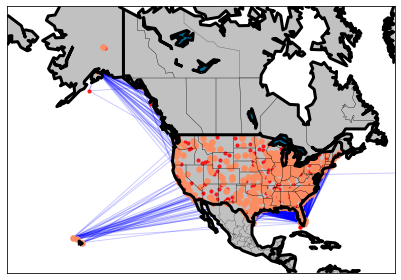

In [6]:

### Genaerate airport network of USA

graph = nx.from_pandas_edgelist(df, source='Origin_airport', target='Destination_airport', edge_attr='Flights')
print(graph.number_of_nodes())

degrees = [val for (node, val) in graph.degree()]
for i in range(len(degrees)):
    degrees[i] = degrees[i]*0.5 
    
nx.draw_networkx_nodes(G = graph, pos = pos, node_list = graph.nodes(),node_color = 'r', alpha = 0.8,node_size = 10,label=True)
nx.draw_networkx_edges(G = graph, pos = pos, edge_color='b', alpha=0.2, arrows = False)

high_degree = [node for node in graph.nodes() if node in locations.Address.unique() and graph.degree(node) > 10]
nx.draw_networkx_nodes(graph, pos = pos,nodelist=high_degree, node_size=30, node_color='#fc8d62')

# drawing states and coastlines on Map

m.drawcountries(linewidth = 3)
m.drawstates(linewidth = 0.2)
m.drawcoastlines(linewidth=3)
m.fillcontinents(color='#c1c1c1',lake_color='#006994')
# plt.figure(figsize = (40,40))
plt.tight_layout()
plt.savefig("flightmap.png", format = "png", dpi = 300)
plt.show()



In [7]:

# Function name : plotDegreeDistribution()
# Parameters    : Graph of networkx (G=nx.graph)
# Description   : It plots the Degree histogram of a graph

def plotDegreeDistribution(G,name):
    degree_sequence = sorted([d for n, d in G.degree()], reverse=True)  # degree sequence
    # print "Degree sequence", degree_sequence
    degreeCount = collections.Counter(degree_sequence)
    deg, cnt = zip(*degreeCount.items())
    plt.figure(figsize=(6,6))
    plt.bar(deg, cnt, width=0.80, color='c')
    plt.title("Degree Histogram")
    plt.ylabel("Count")
    plt.xlabel("Degree")
    plt.savefig(name+"DegreeDistribution.png",format = "png", dpi = 300)
    plt.show()



In [8]:

# Function name : graphShow()
# Parameters    : Graph of networkx (G=nx.graph)
# Description   : It prints the following properties of the networkx Graph.
#                   1.Number of nodes
#                   2.Number of edges
#                   3.Average degree
#                   4.Clustering coefficient
#                   5.AverageShotestPathLength
#                   6.Number of connected subgarphs if graph is disconnected
#                 It geneartes a graph whose nodes are labelled, so visualisation of a graph becomes clear 
#                 if we want to compare between the current and previous graph after removal of a edge or 
#                 a node.

def graphShow(Grand,name):
    print(nx.info(Grand))
    print("Clustering coefficient ="+"{:.2f}".format(nx.algorithms.average_clustering(Grand)) )
    if(nx.is_connected(Grand)):
        print("AverageShotestPathLength ="+"{:.2f}".format(nx.average_shortest_path_length(Grand)))
    else: 
        print("Number of connected subgraphs ="+"{:.2f}".format(nx.number_connected_components(Grand)) )
        print("AverageShotestPathLength =")
        for C in nx.connected_component_subgraphs(Grand):
            print("{:.2f}".format(nx.average_shortest_path_length(C)))
            
    degrees = [val for (node, val) in graph.degree()]
    for i in range(len(degrees)):
        degrees[i] = degrees[i]*80
    plt.figure(figsize=(30,30))
    nx.draw_spring(Grand,with_labels=True,node_size = degrees,node_color = "lightblue")
    plt.title(name)
    plt.savefig(name+".png",format = "png", dpi = 300)
    plt.show()
    plotDegreeDistribution(Grand,name)




<h3 id="Graph-visualization-of-Airport-network-of-USA">Graph visualization of Airport network of USA<a class="anchor-link" href="#Graph-visualization-of-Airport-network-of-USA">¶</a></h3><h4 id="nodes-are-labelled-by-the-name-of-their-airport">nodes are labelled by the name of their airport<a class="anchor-link" href="#nodes-are-labelled-by-the-name-of-their-airport">¶</a></h4>


Name: 
Type: Graph
Number of nodes: 508
Number of edges: 8656
Average degree:  34.0787
Clustering coefficient =0.57
AverageShotestPathLength =2.22


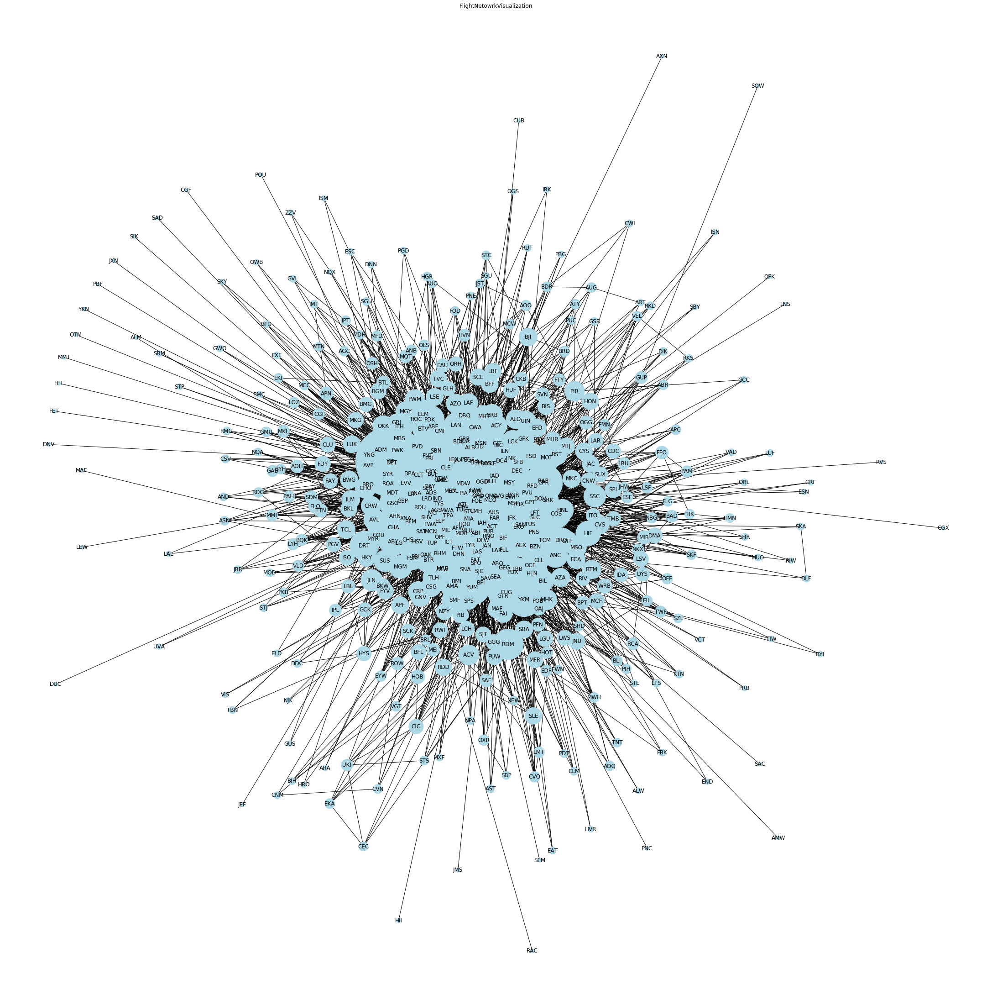

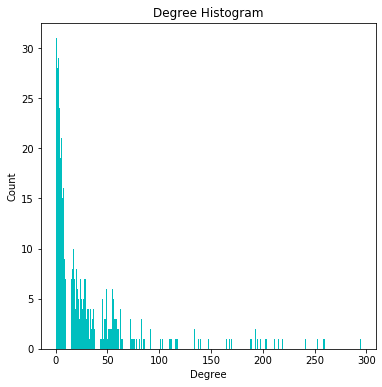

In [9]:

graphShow(graph,"FlightNetowrkVisualization")




<h3 id="Compute-Basic-Network-Properties">Compute Basic Network Properties<a class="anchor-link" href="#Compute-Basic-Network-Properties">¶</a></h3>


In [10]:

# Function name : ComputeNetworkProperties()
# Parameters    : G (networkx graph)
# Description   : It computes the number of nodes and degrees, Degree and clustering size of each node,
#                 connected components,average clustering coefficient,characteristic path length and 
#                 degree histogram of a given graph

def ComputeNetworkProperties(G):
    print(nx.info(G))
    print()
    x  = G.number_of_nodes()
    for i in G.nodes():
        print("Node: "+str(i)+",          Degree= "+ str(G.degree[i])+",        clustering coefficient= " + str("{:.2f}".format(nx.clustering(G,i))))
    print()    
    print("Average Clustering coefficient = "+"{:.2f}".format(nx.algorithms.average_clustering(G)))
    if(nx.is_connected(G)):
        print("Average Shortest Path Length = "+"{:.2f}".format(nx.average_shortest_path_length(G)))
    else: 
        print("Number of connected subgraphs = "+"{:.2f}".format(nx.number_connected_components(G)))
        print("Average Shortest Path Length = ")
        for C in nx.connected_component_subgraphs(G):
            print("{:.2f}".format(nx.average_shortest_path_length(C)))



In [11]:

ComputeNetworkProperties(graph)    ## call ComputeNetworkProperties() to compute the network properties



Name: 
Type: Graph
Number of nodes: 508
Number of edges: 8656
Average degree:  34.0787

Node: MHK,          Degree= 25,        clustering coefficient= 0.53
Node: AMW,          Degree= 1,        clustering coefficient= 0.00
Node: EUG,          Degree= 83,        clustering coefficient= 0.29
Node: RDM,          Degree= 56,        clustering coefficient= 0.26
Node: MFR,          Degree= 16,        clustering coefficient= 0.54
Node: SEA,          Degree= 59,        clustering coefficient= 0.47
Node: PDX,          Degree= 52,        clustering coefficient= 0.48
Node: LMT,          Degree= 7,        clustering coefficient= 0.62
Node: SFO,          Degree= 59,        clustering coefficient= 0.49
Node: LAX,          Degree= 61,        clustering coefficient= 0.53
Node: EAT,          Degree= 3,        clustering coefficient= 1.00
Node: YKM,          Degree= 70,        clustering coefficient= 0.32
Node: EKO,          Degree= 153,        clustering coefficient= 0.21
Node: SLE,          Degree= 17

Node: DIK,          Degree= 4,        clustering coefficient= 0.17
Node: OGD,          Degree= 55,        clustering coefficient= 0.41
Node: BMC,          Degree= 3,        clustering coefficient= 1.00
Node: SGU,          Degree= 3,        clustering coefficient= 0.33
Node: MUO,          Degree= 3,        clustering coefficient= 1.00
Node: OFF,          Degree= 7,        clustering coefficient= 0.67
Node: OFK,          Degree= 1,        clustering coefficient= 0.00
Node: PUC,          Degree= 4,        clustering coefficient= 0.50
Node: PVU,          Degree= 48,        clustering coefficient= 0.35
Node: NZY,          Degree= 16,        clustering coefficient= 0.72
Node: CVO,          Degree= 7,        clustering coefficient= 0.67
Node: SEM,          Degree= 1,        clustering coefficient= 0.00
Node: MDH,          Degree= 5,        clustering coefficient= 1.00
Node: SGH,          Degree= 4,        clustering coefficient= 1.00
Node: OLS,          Degree= 7,        clustering coefficien


<h3 id="Compute-Clustering-coefficient-vs-degree-plot">Compute Clustering coefficient vs degree plot<a class="anchor-link" href="#Compute-Clustering-coefficient-vs-degree-plot">¶</a></h3>


In [12]:

# Function name : plotCCvsK()
# Parameters    : G (networkx graph)
# Description   : It plot the graph between Clustering coefficient and degree.
#                 It plots the corresponding CC for the node having some certain degree  

def plotCCvsK(G):
    degrees = [val for (node, val) in G.degree()]
    degrees.sort()
    
    my_set = set(degrees)
    degrees = list(my_set)
    
    CC = {}
    for i in G.nodes():
        if G.degree[i] in CC:
            CC[G.degree[i]].add(nx.clustering(G,i))
        else:
            CC[G.degree[i]] = {nx.clustering(G,i)}
            
    temp = []
    for i in range(len(degrees)):
            if degrees[i] in CC:
                x = list(CC[degrees[i]])
                temp.append(x)

    for xe, ye in zip(degrees, temp):
        plt.scatter([xe] * len(ye), ye)

    plt.xscale("log")
    plt.yscale("log")
    plt.xlabel('k')     
    plt.ylabel('CC')
    plt.title('CC vs K')
    plt.savefig("CCvsK.png", format = "png", dpi = 300)
    plt.show()
    



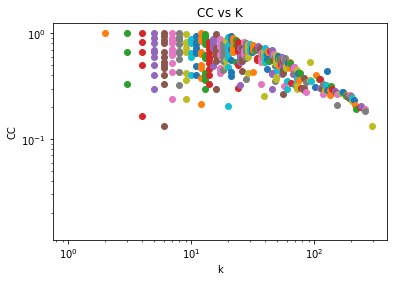

In [13]:

plotCCvsK(graph)




<h3 id="Compute-Knn-vs-degree-plot">Compute Knn vs degree plot<a class="anchor-link" href="#Compute-Knn-vs-degree-plot">¶</a></h3>


In [14]:

# Function name : KnnvsK()
# Parameters    : G (networkx graph)
# Description   : It plot the graph between average degree of nearest neighbour with that degree in the graph.

def KnnvsK(G):

    Kneighbour = nx.k_nearest_neighbors(G)
    
    degrees = [val for (node, val) in G.degree()]
    k = degrees
    degrees.sort()
    
    my_set = set(degrees)
    degrees = list(my_set)
    
    Knn = {}
    for i in range(G.number_of_nodes()):
        if k[i] in Knn:
            Knn[k[i]].add(Kneighbour.get(k[i]))
        else:
            Knn[k[i]] = {Kneighbour.get(k[i])}
            
    temp = []
    for i in range(len(degrees)):
            if degrees[i] in Knn:
                temp.append(sum(Knn[degrees[i]])/len((Knn[degrees[i]])))
            else:
                print("not",degrees[i])
    
    plt.scatter(degrees,temp,c='r')
    plt.xscale("log")
    plt.yscale("log")
    plt.xlabel('k')     
    plt.ylabel('Knn')
    plt.title('Knn vs K')
    plt.savefig("KnnvsK.png", format = "png", dpi = 300)
    plt.show() 



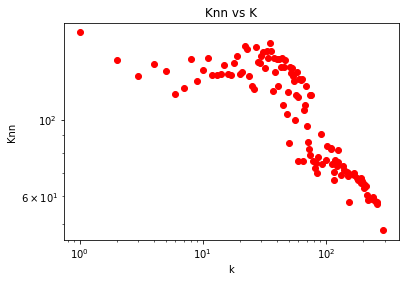

In [15]:

KnnvsK(graph)




<h3 id="Compute-Strength-vs-degree-plot">Compute Strength vs degree plot<a class="anchor-link" href="#Compute-Strength-vs-degree-plot">¶</a></h3>


In [55]:

# Function name : Strengthvsk()
# Parameters    : G (networkx graph)
# Description   : It plot the graph between the strength vs degree in the graph.

def Strengthvsk(G):
    degrees = [val for (node, val) in G.degree()]
    k = degrees
    degrees.sort()
    
    my_set = set(degrees)
    degrees = list(my_set)
    Sk = {}
    for i in range(G.number_of_nodes()):
        if k[i] in Sk:
            Sk[k[i]].add(k[i]/2*G.number_of_edges())
        else:
            Sk[k[i]] = {k[i]/2*G.number_of_edges()}
    temp = []
    for i in range(len(degrees)):
            if degrees[i] in Sk:
                temp.append(sum(Sk[degrees[i]])/len((Sk[degrees[i]])))
            else:
                print("not",degrees[i])
    
    plt.scatter(degrees,temp,c='c')
    plt.xscale("log")
    plt.yscale("log")
    plt.xlabel('k')     
    plt.ylabel('Sk')
    plt.title('Sk vs K')
    plt.savefig("SkvsK.png", format = "png", dpi = 300)
    plt.show()



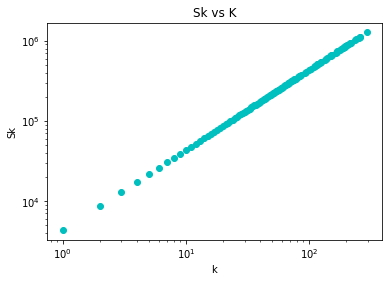

In [56]:

Strengthvsk(graph)




<h3 id="Compute-Cummulative-Probability-Distribution-plot">Compute Cummulative Probability Distribution plot<a class="anchor-link" href="#Compute-Cummulative-Probability-Distribution-plot">¶</a></h3>


In [18]:

# Function name : CummulativeProbDistribution()
# Parameters    : G (networkx graph)
# Description   : It plot the Cummulative Probability Distribution graph.

def CummulativeProbDistribution(G):
    degree_sequence = sorted([d for n, d in G.degree()], reverse=True)  # degree sequence
    # print "Degree sequence", degree_sequence
    degreeCount = collections.Counter(degree_sequence)
    deg, cnt = zip(*degreeCount.items())
    totaldeg = sum(deg)
    for i in cnt:
        i = i/totaldeg
    plt.figure(figsize=(6,6))
    plt.scatter(deg, cnt, color='m')
    plt.xscale("log")
    plt.yscale("log")
    plt.title("Cumulative Probability Distribution")
    plt.ylabel("P(k)")
    plt.xlabel("k")
    plt.savefig("CumulativeProbabilityDistribution.png", format = "png", dpi = 300)
    plt.show()



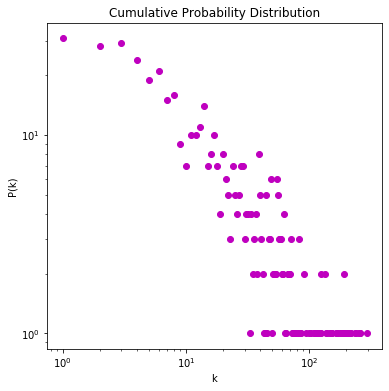

In [19]:

CummulativeProbDistribution(graph)




<h3 id="Compute-Cummulative-weight-Distribution-plot">Compute Cummulative weight Distribution plot<a class="anchor-link" href="#Compute-Cummulative-weight-Distribution-plot">¶</a></h3>


In [20]:

# Function name : CummulativeWeightDistribution()
# Parameters    : G (networkx graph)
# Description   : It plot the Cummulative weight Distribution graph.

def CummulativeWeightDistribution(G):
    NumberofFlights = noOfFlights.tolist()   
    totalFlights = sum(NumberofFlights)
    degree_sequence = sorted([d for d in NumberofFlights], reverse=True)  # degree sequence
    # print "Degree sequence", degree_sequence
    degreeCount = collections.Counter(degree_sequence)
    deg, cnt = zip(*degreeCount.items())
    totaldeg = sum(deg)
    for i in cnt:
        i = i/totaldeg
    plt.figure(figsize=(8,6))
    plt.scatter(deg, cnt, color='c')
    plt.xscale("log")
    plt.yscale("log")
    plt.title("Cumulative weight Distribution")
    plt.ylabel("P(w)")
    plt.xlabel("w")
    plt.savefig("CumulativeWeightDistribution.png", format = "png", dpi = 300)
    plt.show() 



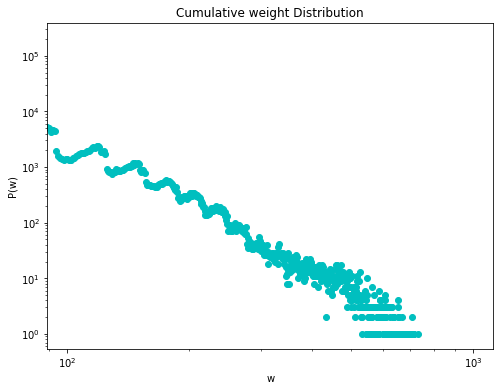

In [21]:

CummulativeWeightDistribution(graph)




<h3 id="Compute-shortest-path-from-source-to-destination-airports">Compute shortest path from source to destination airports<a class="anchor-link" href="#Compute-shortest-path-from-source-to-destination-airports">¶</a></h3><h4 id="number-of-flight-switching-required-during-journey-from-source-to-destination">number of flight switching required during journey from source to destination<a class="anchor-link" href="#number-of-flight-switching-required-during-journey-from-source-to-destination">¶</a></h4>


In [22]:

# Function name : ShortestPath()
# Parameters    : G (networkx graph)
# Description   : It plots the shortest path(stops required in between) between src and dest nodes with its count in the network.

def ShortestPath(graph):
    Address = locations.Address
    print(len(Address))
    ShortestPath = []
    for i in Address:
        p = nx.shortest_path_length(graph, source=i)
        l = p.values()
        l = list(l)
        val = round(sum(l)/len(l))
        ShortestPath.append(val)

    degree_sequence = sorted([d for d in ShortestPath], reverse=True)  # degree sequence
    degreeCount = collections.Counter(degree_sequence)
    deg, cnt = zip(*degreeCount.items())
    totaldeg = sum(deg)

    plt.plot(deg, cnt, '-o')
    plt.title("Shortest Path length")
    plt.ylabel("count")
    plt.xlabel("Lij")
    plt.savefig("ShortestPathlength.png", format = "png", dpi = 300)
    plt.show()      



508


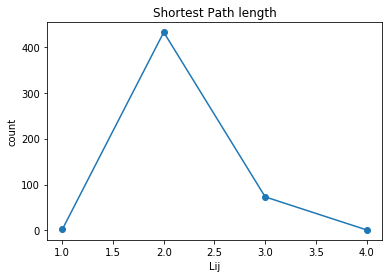

In [23]:

ShortestPath(graph)



In [24]:

# Function name : ShowShortestPath()
# Parameters    : path (shortest path nodes)
# Description   : It plots the shortest path network on the USA terrain. 

def ShowShortestPath(path):
    df1 = df.values.tolist()
    edgelist_flights = []

    for idx,row in enumerate(df1, 1):
            Origin_airport,Destination_airport,Flights = row
            if (Origin_airport in path and Destination_airport in path and Origin_airport!=Destination_airport):
                edgelist_flights.append((row[0],row[1],row[2]))

                 
    set_edge = set(edgelist_flights)
    edgelist_flights = list(set_edge)
    
    
    code = []
    latlong = []

    loc = locations.values.tolist()
    for idx,row in enumerate(loc, 1):
            Address,Latitude,Longitude = row
            if Address in path:
                code.append(row[0])
                latlong.append((row[0],row[1],row[2]))

    
    edgelist_flightsp = pd.DataFrame((list(edgelist_flights)),columns =['Origin_airport', 'Destination_airport','Flights']) 
    latlongp = pd.DataFrame((list(latlong)),columns =['Address','Latitude','Longitude'])
    
    
    m1 = Basemap(projection='merc',llcrnrlon=-180,llcrnrlat=10,urcrnrlon=-50,
    urcrnrlat=70, lat_ts=0, resolution='c',suppress_ticks=True)
    
    
    mx1, my1 = m1(latlongp['Longitude'].values, latlongp['Latitude'].values)

    pos1 = {}
    for count, elem in enumerate (latlongp['Address']):
         pos1[elem] = (mx1[count], my1[count])
    
    g = nx.from_pandas_edgelist(edgelist_flightsp, source='Origin_airport', target='Destination_airport', edge_attr='Flights') 
    degrees = [val for (node, val) in g.degree()]
    for i in range(len(degrees)):
        degrees[i] = degrees[i]*400
    nx.draw_networkx_nodes(G = g, pos = pos1, node_list = g.nodes(),node_color = 'r', alpha = 0.8,node_size = degrees,label=True)
    nx.draw_networkx_edges(G = g, pos = pos1, edge_color='b', alpha=1, arrows = False)

    node_lb = dict(zip(code, code))
    nx.draw_networkx_labels(g,pos=pos1,labels=node_lb)
    
    m1.drawcountries(linewidth = 3)
    m1.drawstates(linewidth = 0.2)
    m1.drawcoastlines(linewidth=3)
    plt.tight_layout()
    plt.title('source and destination connectivity')
    plt.savefig("shortestPath.png", format = "png", dpi = 300)
    plt.show()   
    

    plt.figure(figsize = (3,3))
    nx.draw_circular(g,with_labels=True,node_size = degrees)
    plt.show()



In [25]:

# Function name : ShortestPathBetweenAirports()
# Parameters    : graph(airport network graph),src,dest(airports)
# Description   : It returns the shortest path between src and dest airports.
#                 It plots the shortest path network on the USA terrain. 

def ShortestPathBetweenAirports(graph,src,dest):
    
    print()
    print("Airports to travel to reach from "+str(src)+" to "+str(dest)+" is/are:")
    path = nx.astar_path(graph, src, dest)
    print(path)
    ShowShortestPath(path)
    



In [26]:

# Function name : ShowAirportsList()
# Parameters    : None
# Description   : It prints the all the airports present in airport network

def ShowAirportsList():
    Address = locations.Address
    print("List of airports are:")
    print()
    print(Address.tolist())



In [27]:

ShowAirportsList()



List of airports are:

['ITO', 'ORL', 'MHR', 'FSM', 'PNC', 'SVN', 'GFK', 'PBF', 'TTN', 'BOS', 'BFM', 'OAK', 'OMA', 'OGG', 'ICT', 'MCI', 'MSN', 'HRO', 'PHX', 'BGR', 'FXE', 'GGG', 'AND', 'GEG', 'SFO', 'ARA', 'GNV', 'MEM', 'CNW', 'POB', 'DLF', 'LAX', 'ANB', 'CLE', 'DOV', 'CVG', 'HON', 'JNU', 'LFT', 'EWR', 'GCK', 'MOT', 'MXF', 'DAL', 'HLN', 'NKX', 'LUF', 'END', 'LCH', 'MYR', 'DCA', 'BYH', 'ACY', 'TIK', 'PUB', 'GRF', 'ADQ', 'FLL', 'SLC', 'LSF', 'MDT', 'LNK', 'LAN', 'HKY', 'IAH', 'BFL', 'ELP', 'CAE', 'DMA', 'NPA', 'PNS', 'HOU', 'PIT', 'EFD', 'VAD', 'MIA', 'SEA', 'CHA', 'BDR', 'JAN', 'IPT', 'IND', 'SZL', 'GWO', 'JBR', 'NZY', 'BIF', 'YUM', 'CNM', 'DLH', 'HUF', 'HVR', 'MWH', 'RIC', 'SHV', 'BPT', 'SAV', 'HIF', 'SAT', 'ROC', 'RCA', 'RDU', 'DAY', 'ESF', 'LTS', 'TUS', 'MIB', 'GSB', 'PVD', 'SBY', 'DTW', 'TPA', 'EIL', 'MAF', 'GRB', 'ADM', 'AGS', 'ISN', 'LIT', 'SAC', 'TBN', 'SKA', 'PAM', 'DFW', 'TCM', 'AUS', 'LCK', 'MQT', 'TYS', 'STL', 'SPS', 'LUK', 'ATL', 'MCC', 'GRR', 'FAT', 'IPL', 'BNA', 'LRD', 'ED


<h2 id="Show-shortest-path-between-source-to-destination-airport-on-USA-terrain">Show shortest path between source to destination airport on USA terrain<a class="anchor-link" href="#Show-shortest-path-between-source-to-destination-airport-on-USA-terrain">¶</a></h2>



Airports to travel to reach from SHR to SUX is/are:
['SHR', 'EKO', 'SUX']


/home/anuj/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:35: MatplotlibDeprecationWarning: 
The dedent function was deprecated in Matplotlib 3.1 and will be removed in 3.3. Use inspect.cleandoc instead.
/home/anuj/anaconda3/lib/python3.7/site-packages/networkx/drawing/nx_pylab.py:579: MatplotlibDeprecationWarning: 
The iterable function was deprecated in Matplotlib 3.1 and will be removed in 3.3. Use np.iterable instead.
  if not cb.iterable(width):
/home/anuj/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:54: MatplotlibDeprecationWarning: 
The dedent function was deprecated in Matplotlib 3.1 and will be removed in 3.3. Use inspect.cleandoc instead.
/home/anuj/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: 
The dedent function was deprecated in Matplotlib 3.1 and will be removed in 3.3. Use inspect.cleandoc instead.


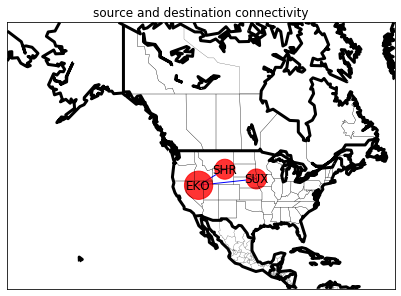

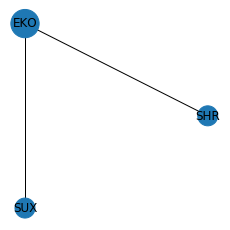

In [28]:

ShortestPathBetweenAirports(graph,"SHR","SUX")




<h3 id="Create-corresponding-random-graph-to-airport-network-of-USA">Create corresponding random graph to airport network of USA<a class="anchor-link" href="#Create-corresponding-random-graph-to-airport-network-of-USA">¶</a></h3>


In [29]:

# Function name : CreateGraph()
# Parameters    : N (number of nodes) and p (probability)
# Description   : it craete a graph with number of nodes N and generates a random probability between 0 and 1
#                 and checks if it is less than the probability(p), then it forms an edge between the nodes


def CreateGraph(N,p,maxW):
    labels={}
    G = nx.Graph()
    rows,cols = (N,N)
    for i in range(1,cols):
        G.add_node(i)                          ## Adding nodes to the graph using add_node() of networkx
    arr=np.zeros((rows,cols),dtype=np.int32)
    for i in range(rows):      
        for j in range(i):
            val = random()
            w = randrange(maxW)
            if(val<=p):
                G.add_edge(i,j,weight=w)                ## Adding edges to the graph using add_edge() of networkx
    for i in range(1,rows):
        labels[i] = i;                         ## Adding labels to the nodes
    nx.set_node_attributes(G, labels, 'labels')
    return G



In [30]:

# Function name : CompareRealandRandomNetwork()
# Parameters    : RealGraph (real graph), RandomGraph (corresponding random graph to real graph)
# Description   : It compares the graph by following properties:
#                 1. Basic Info (Number of edges), Average Degree
#                 2. Average Clustering coefficient
#                 3. Average Shortest Path Length
#                 4. Number of connected components
#                 5. graph representation
#                 6. Degree Histogram

def CompareRealandRandomNetwork(RealGraph,RandomGraph,index):
    if(index == 0):
        
        print("Real graph: ",nx.info(RealGraph))
        print()
        print("Random graph "+str(index)+" :",nx.info(RandomGraph))
        print()
        
        print("Real graph: ")
        print("Clustering coefficient ="+"{:.2f}".format(nx.algorithms.average_clustering(RealGraph)) )
        if(nx.is_connected(RealGraph)):
            print("Average Shortest Path Length ="+"{:.2f}".format(nx.average_shortest_path_length(RealGraph)))
        else: 
            print("Number of connected subgraphs ="+"{:.2f}".format(nx.number_connected_components(RealGraph)) )
            print("Average Shortest Path Length =")
            
            for C in nx.connected_component_subgraphs(RealGraph):
                
                print("{:.2f}".format(nx.average_shortest_path_length(C)))

        print()  
    
        print("Random graph "+str(index)+" :")
        print("Clustering coefficient ="+"{:.2f}".format(nx.algorithms.average_clustering(RandomGraph)) )
        if(nx.is_connected(RandomGraph)):
            print("Average Shortest Path Length ="+"{:.2f}".format(nx.average_shortest_path_length(RandomGraph)))
        else: 
            print("Number of connected subgraphs ="+"{:.2f}".format(nx.number_connected_components(RandomGraph)) )
            print("Average Shortest Path Length =")
            lsumASPL = 0
            for C in nx.connected_component_subgraphs(RandomGraph):
                lsumASPL += round(nx.average_shortest_path_length(C),2)
                print("{:.2f}".format(nx.average_shortest_path_length(C)))
                print(lsumASPL/nx.number_connected_components(RandomGraph))

    if(index==0): 
        print()
        print("Real graph: ")      
        plt.figure(figsize=(60,60))   
        nx.draw(RealGraph,with_labels = True)
#         plt.savefig("real.png", format = "png", dpi = 150)
        plt.show() # display

        print()
        print("Random graph "+str(index)+" :")      
        plt.figure(figsize=(60,60))   
        nx.draw(RandomGraph)
    #     plt.savefig("random.png", format = "png", dpi = 150)
        plt.show() # display      


        print()
        print("Real graph: ")            
        plotDegreeDistribution(RealGraph,"RealGraph")

        print()
        print("Random graph:")      
        plotDegreeDistribution(RandomGraph,"randomGraph")
        
        
        
    ASPL = 0.0
    if(nx.is_connected(RandomGraph)):
        ASPL = nx.average_shortest_path_length(RandomGraph)
    else: 
        lsumASPL = 0
        for C in nx.connected_component_subgraphs(RandomGraph):
            lsumASPL += round(nx.average_shortest_path_length(C),2)
        ASPL = lsumASPL/nx.number_connected_components(RandomGraph)
        
    return RandomGraph.number_of_edges(),nx.degree(RandomGraph),nx.algorithms.average_clustering(RandomGraph),ASPL




<h3 id="Comparng-the-airport-network-of-USA-with-its-corresponding-random-graph">Comparng the airport network of USA with its corresponding random graph<a class="anchor-link" href="#Comparng-the-airport-network-of-USA-with-its-corresponding-random-graph">¶</a></h3>


  0%|          | 0/100 [00:00<?, ?it/s]

Real graph:  Name: 
Type: Graph
Number of nodes: 508
Number of edges: 8656
Average degree:  34.0787

Random graph 0 : Name: 
Type: Graph
Number of nodes: 508
Number of edges: 34099
Average degree: 134.2480

Real graph: 
Clustering coefficient =0.57
Average Shortest Path Length =2.22

Random graph 0 :
Clustering coefficient =0.26
Average Shortest Path Length =1.74

Real graph: 


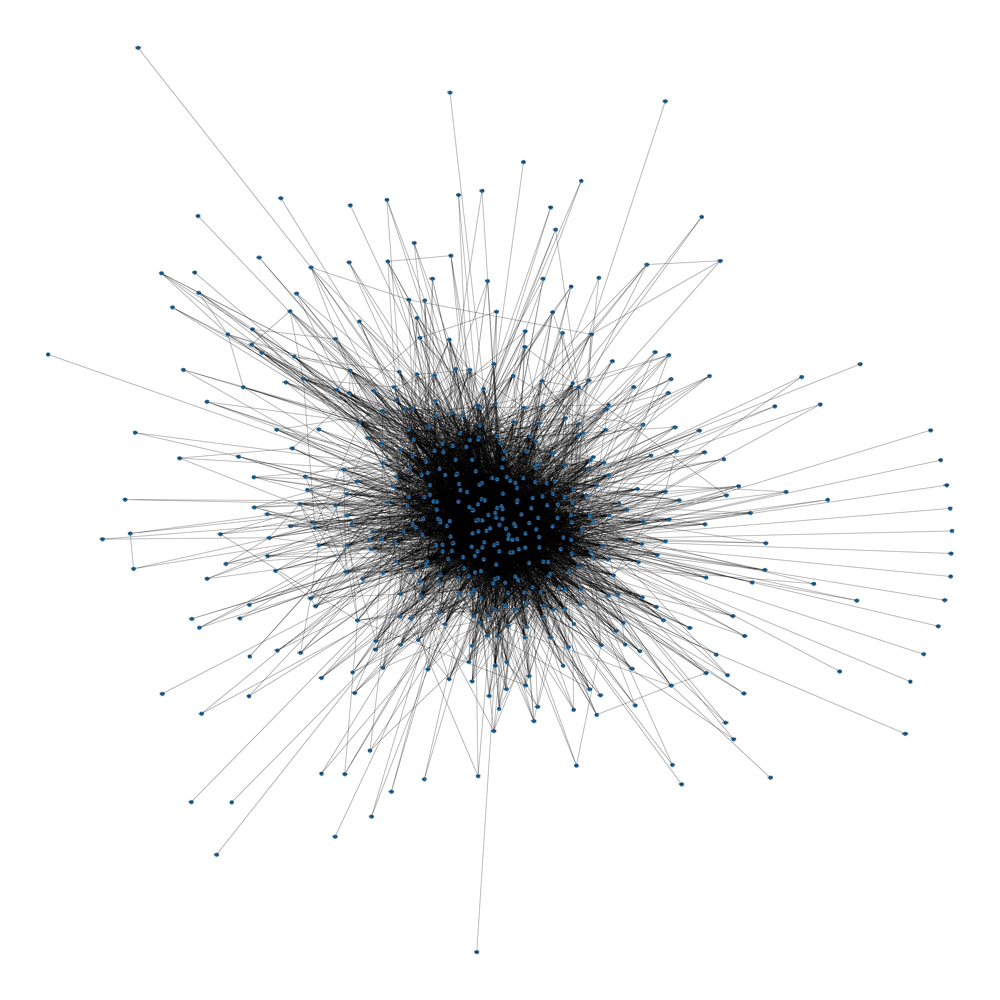


Random graph 0 :


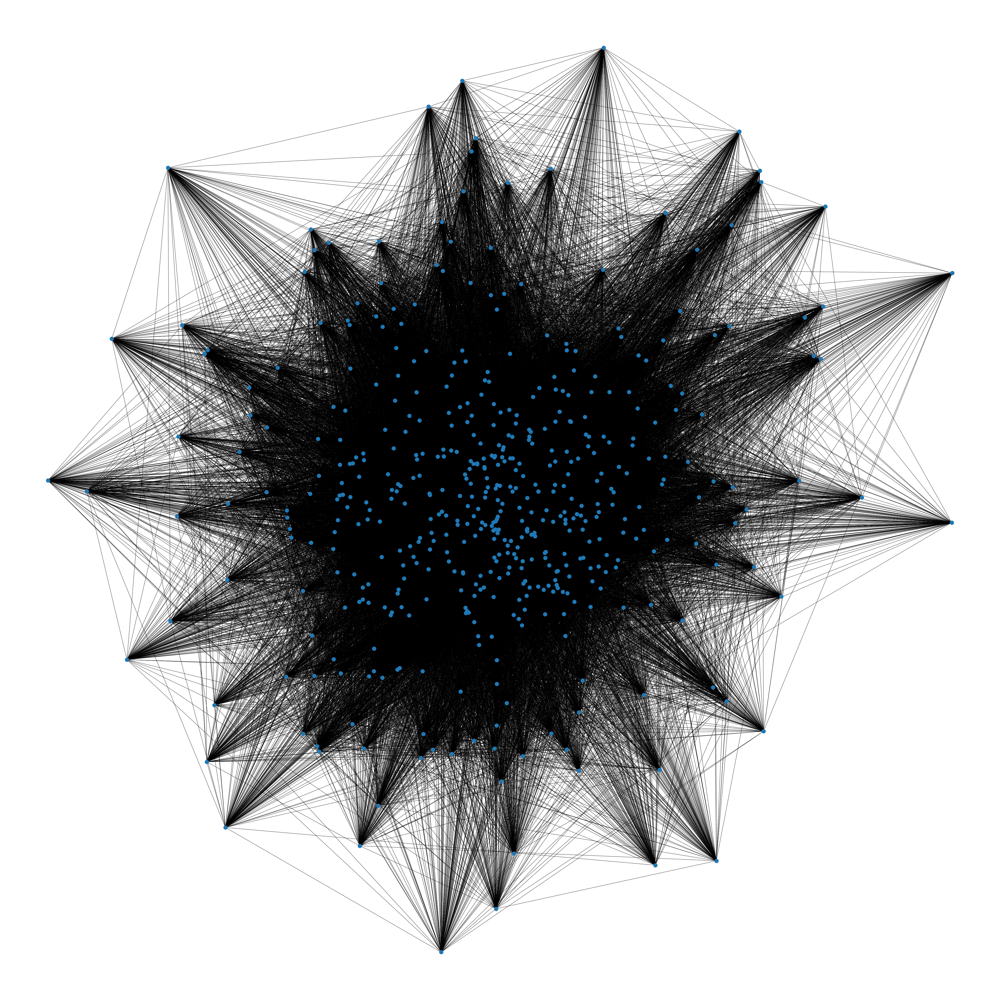


Real graph: 


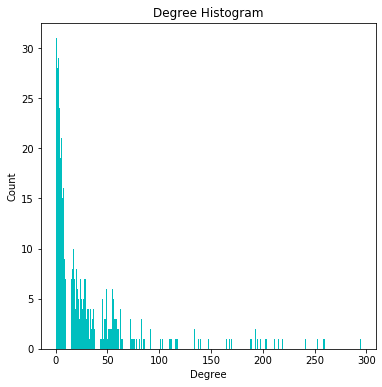


Random graph:


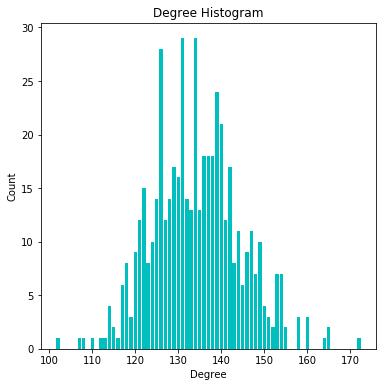

100%|██████████| 100/100 [30:14<00:00, 18.14s/it]


In [31]:
# degRanlist = []
# CCRanlist = []
# ASPLRanlist = []
# NumberOfEdges = []
NumberofFlights = noOfFlights.tolist()
from statistics import mean
from time import sleep
from tqdm import tqdm
for i in tqdm(range(100)):
    p = random()
    RandomGraph = CreateGraph(graph.number_of_nodes(),p,max(NumberofFlights))
    NE,degRan,CCRan,ASPLRan = CompareRealandRandomNetwork(graph,RandomGraph,i)
#     NumberOfEdges.append(NE)
#     degRanlist.append(degRan)
#     CCRanlist.append(CCRan)
#     ASPLRanlist.append(ASPLRan)
#     sleep(0.01)

In [32]:
# # mindegRan = min(degRanlist)
# # maxdegRan = max(degRanlist)
# # meandegRan = mean(degRanlist)

# minCCRan = min(CCRanlist)
# maxCCRan = max(CCRanlist)
# meanCCRan = mean(CCRanlist)

# minASPLRan = min(ASPLRanlist)
# maxASPLRan = max(ASPLRanlist)
# meanASPLRan = mean(ASPLRanlist)

# minNumEdges = min(NumberOfEdges)
# maxNumEdges = max(NumberOfEdges)
# meanNumEdges = mean(NumberOfEdges)


# print("CC",minCCRan,maxCCRan,meanCCRan)
# print("ASPL",minASPLRan,maxASPLRan,meanASPLRan)
# # print("deg",mindegRan,maxdegRan,meandegRan)
# print("NumberOfEdges",minNumEdges,maxNumEdges,meanNumEdges)


<h2 id="Creating-graph-between-the-states-and-the-airports-of-that-states-with-number-of-covid-19-cases">Creating graph between the states and the airports of that states with number of covid 19 cases<a class="anchor-link" href="#Creating-graph-between-the-states-and-the-airports-of-that-states-with-number-of-covid-19-cases">¶</a></h2>


In [33]:

# Function name : StatesandAirportsWithCovidCases()
# Parameters    : Covid Flag
# Description   : It creates the graph between the states and the airports within that states.
#                 Two modules are implemented in this function. first without covid flag and second without covid flag.
#                 module in which covid flag is 1, the state node have extra parameter attached with it. 
#                 That is number of positive corona cases in that state.
#                 The size of the node represent the number of positive corona cases in that state.

def StatesandAirportsWithCovidCases(CovidFlag):
    fs1 = ['OCcode','Origin_airport']
    statesCodeO = pd.read_csv('data/AMStates.csv',skipinitialspace=True, usecols=fs1)

    fs2 = ['Dccode','Destination_airport']
    statesCodeD = pd.read_csv('data/AMStates.csv',skipinitialspace=True, usecols=fs2)

    l1 = statesCodeO.values.tolist()
    l2 = statesCodeD.values.tolist()

    l3  = l1+l2

    y = np.unique(l3, axis=0)
    res = [] 
    for i in y:
        res.append(tuple(i))

    res = pd.DataFrame(res,columns =['airport', 'state'])
    states = res.state
    states = states.tolist()

    airports = res.airport
    airports = airports.tolist()

    gs = nx.from_pandas_edgelist(res, source='airport', target='state') 
    
    
    
    layout = nx.spring_layout(gs,iterations=50)
    
    if(CovidFlag==1):
        plt.figure(figsize=(100,100))
        fs3 = ['state','positive']
        covid = pd.read_csv('data/covidfinal.csv',skipinitialspace=True, usecols=fs3)
        
        
        state_size = []
        covid = covid.values.tolist()
        for i in states:
            for j in range(len(covid)):
                if(covid[j][0]):
                    state_size.append(covid[j][1]) 
        state_size1 = []
        for i in state_size:
            state_size1.append(i*0.05)
            
        st = []
        for i in range(len(states)):
            st.append(str(states[i])+" "+str(state_size[i]))
            
        
#         state_size = [gs.degree(s) * 80 for s in states]
        nx.draw_networkx_nodes(gs, 
                               layout, 
                               nodelist=states, 
                               node_size=state_size1, # a LIST of sizes, based on g.degree
                               with_labels=True,
                               node_color='lightblue')

        airport_size = [gs.degree(s) * 10 for s in airports]
        nx.draw_networkx_nodes(gs, 
                               layout, 
                               nodelist=airports, 
                               node_size=airport_size, # a LIST of sizes, based on g.degree
                               with_labels=True,
                               node_color='r')

        nx.draw_networkx_edges(gs, layout, width=1, edge_color="#cccccc")


        node_labels = dict(zip(states, st))
        nx.draw_networkx_labels(gs, layout, labels=node_labels)

        node_label = dict(zip(airports, airports))
        nx.draw_networkx_labels(gs, layout, labels=node_label)

        plt.axis('off')
        plt.savefig("StatesandAirportswithCovidCases.png", format = "png", dpi = 300)
        plt.show()
    else:
        plt.figure(figsize=(60,60)) 
        state_size = [gs.degree(s) * 80 for s in states]
        nx.draw_networkx_nodes(gs, 
                               layout, 
                               nodelist=states, 
                               node_size=state_size, # a LIST of sizes, based on g.degree
                               with_labels=True,
                               node_color='lightblue')

        airport_size = [gs.degree(s) * 10 for s in airports]
        nx.draw_networkx_nodes(gs, 
                               layout, 
                               nodelist=airports, 
                               node_size=airport_size, # a LIST of sizes, based on g.degree
                               with_labels=True,
                               node_color='r')

        nx.draw_networkx_edges(gs, layout, width=1, edge_color="#cccccc")


        node_labels = dict(zip(states, states))
        nx.draw_networkx_labels(gs, layout, labels=node_labels)

        node_label = dict(zip(airports, airports))
        nx.draw_networkx_labels(gs, layout, labels=node_label)

        plt.axis('off')
        plt.savefig("StatesandAirports.png", format = "png", dpi = 300)
        plt.show()
        
        



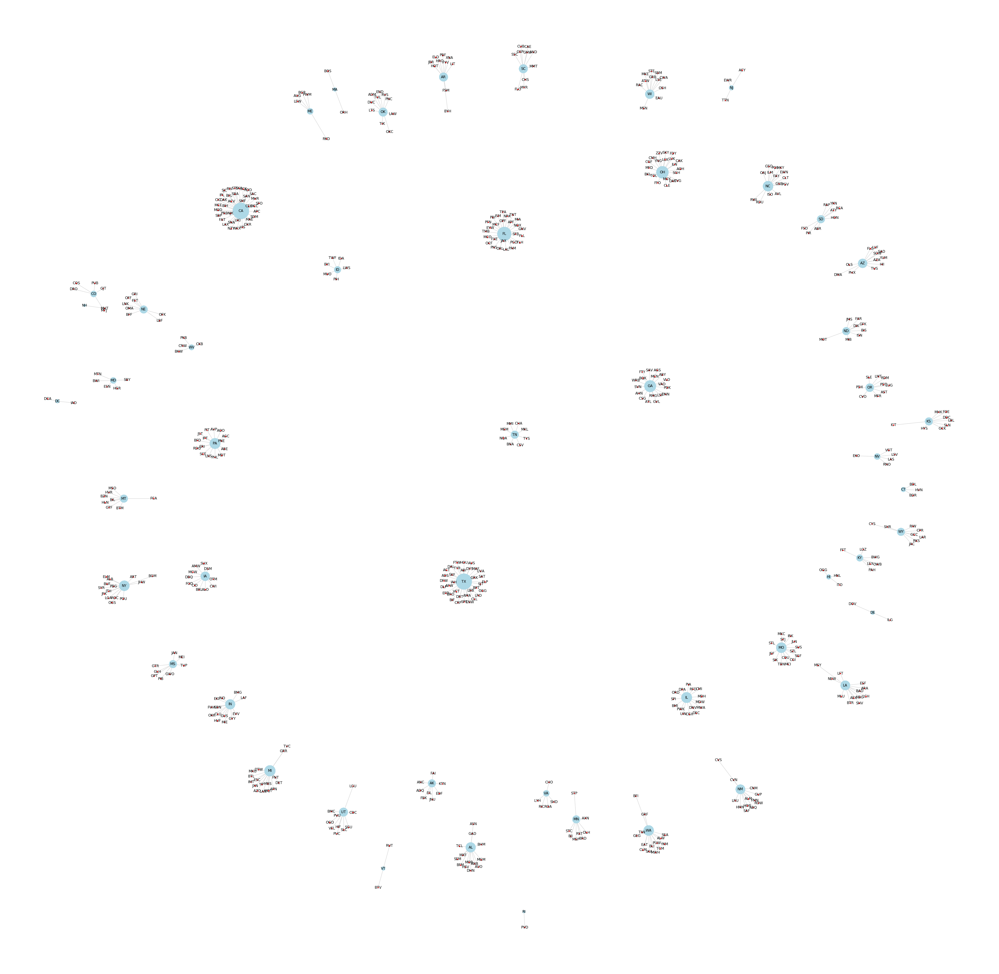

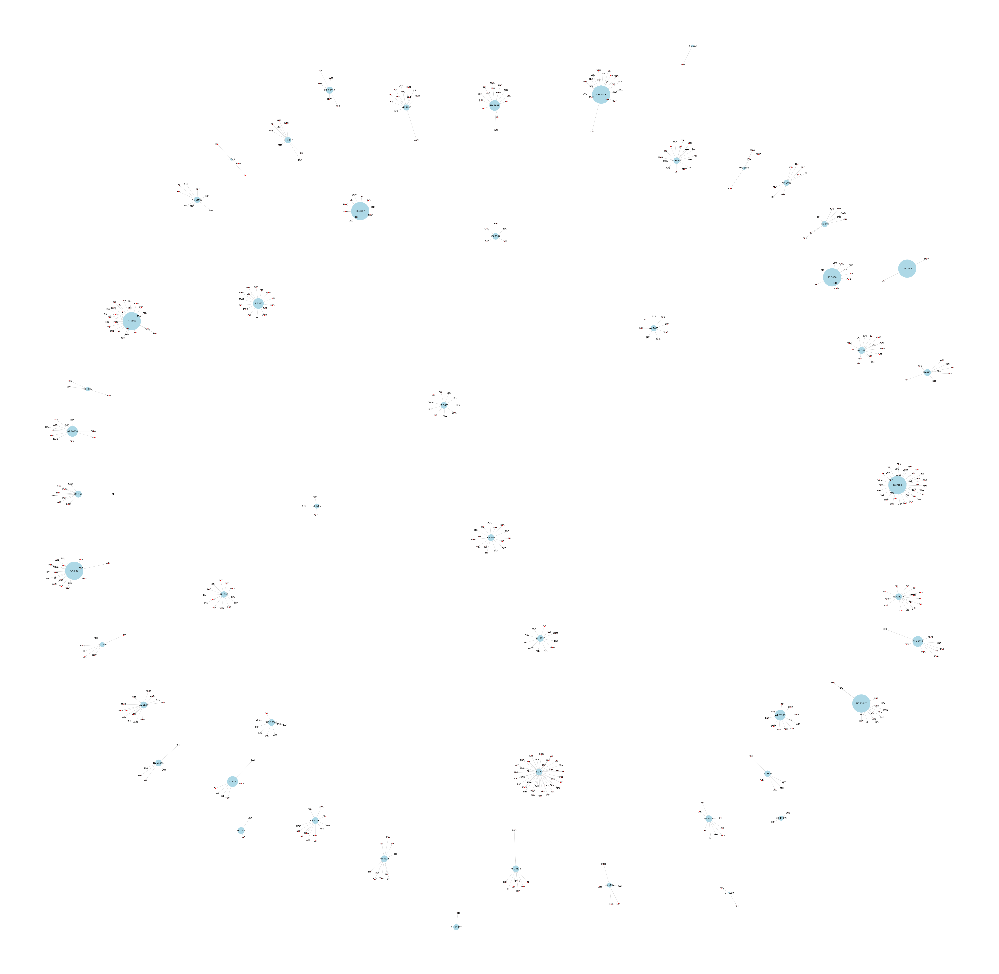

In [34]:

CovidFlag = 0
StatesandAirportsWithCovidCases(CovidFlag)
CovidFlag = 1
StatesandAirportsWithCovidCases(CovidFlag)




<h2 id="Creating-graph-to-represent-connectivity-between-states-if-there-is-direct-flight-exist-between-them">Creating graph to represent connectivity between states if there is direct flight exist between them<a class="anchor-link" href="#Creating-graph-to-represent-connectivity-between-states-if-there-is-direct-flight-exist-between-them">¶</a></h2>


In [35]:

# Function name : StatesConnectivityByFlights()
# Parameters    : None
# Description   : It creates the graph between the states.
#                 The edge between two states represent the direct connectivity of the states by the flights.
#                 compute basic properties of graph to extraxt basic network knowledge of the graph.

def StatesConnectivityByFlights():
    StatesConn = pd.read_csv('data/AMStates.csv',skipinitialspace=True, usecols=['OCcode','Dccode'])
    graphSC = nx.from_pandas_edgelist(StatesConn, source='OCcode', target='Dccode')
    graphShow(graphSC,"StatesConnectivity")



Name: 
Type: Graph
Number of nodes: 51
Number of edges: 979
Average degree:  38.3922
Clustering coefficient =0.86
AverageShotestPathLength =1.27


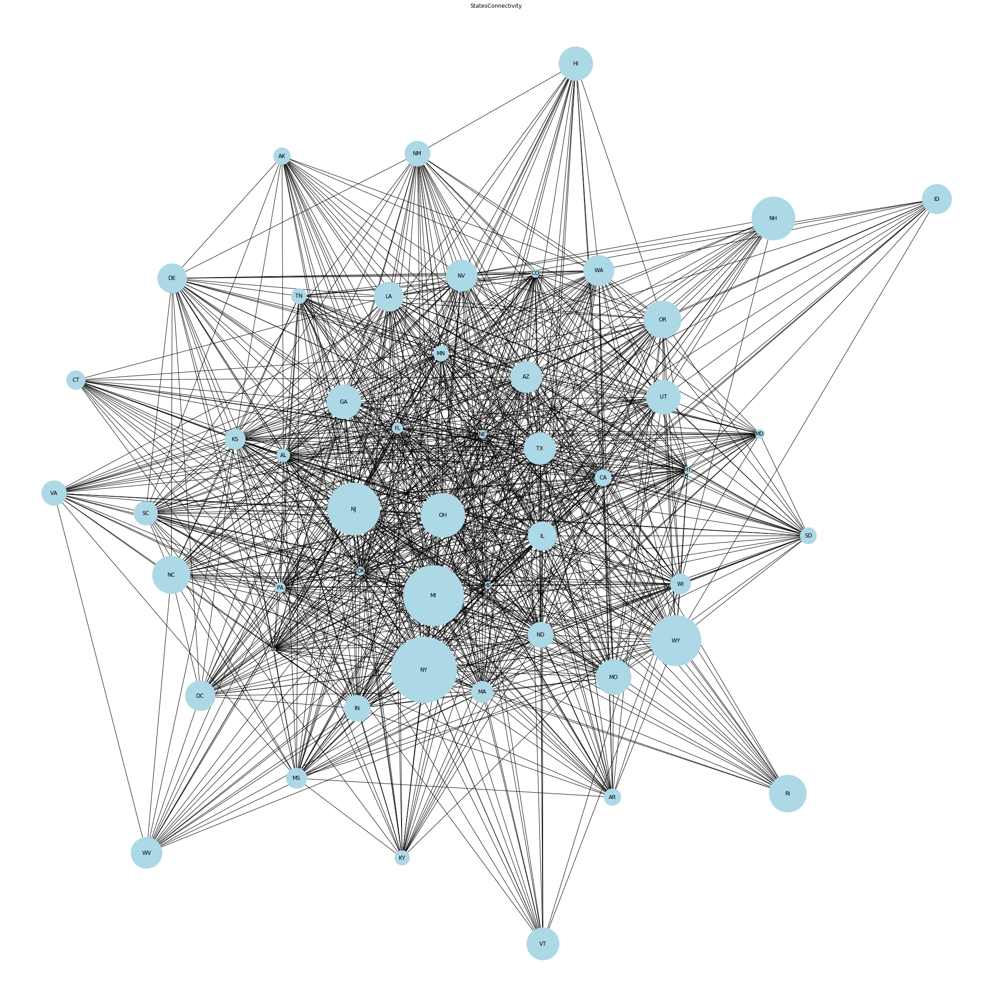

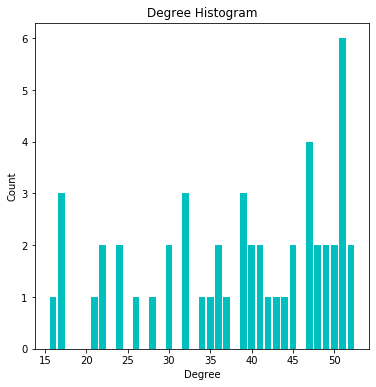

In [36]:

StatesConnectivityByFlights()




<h3 id="Displaying-the-effect-of-covid19-with-time-on-number-of-states-and-on-number-of-people">Displaying the effect of covid19 with time on number of states and on number of people<a class="anchor-link" href="#Displaying-the-effect-of-covid19-with-time-on-number-of-states-and-on-number-of-people">¶</a></h3>


In [37]:

# Function name : TimeseriesCovidAffectedStates()
# Parameters    : None
# Description   : It creates the plot between the dates and the spread of covid to number of statess and to the number of people.
#                 This data(plot) is helpful to analyse the trend of increase of covid19 virus
#                 By the help of these plots, threshold is decided which is the key factor to determine the dependency
#                 of spread of covid19 between the states due to movements of flights.

def TimeseriesCovidAffectedStates():
    dateparse = lambda x: pd.datetime.strptime(x, '%Y%m%d')

    StatesTime = pd.read_csv('data/us_covid19_daily.csv',skipinitialspace=True, usecols=['date','states','positive'],parse_dates=['date'], date_parser=dateparse)
    date = StatesTime.date
    states = StatesTime.states
    positive = StatesTime.positive
    
    date = date.tolist()
    states = states.tolist()
    positive = positive.tolist()
    
    plt.figure(figsize=(20,6)) 
    plt.plot(date, positive, '-o')
    plt.xticks(date, date, rotation='vertical')
    plt.title("date vs Positive cases")
    plt.ylabel("positive cases")
    plt.xlabel("date")
    plt.savefig("datevsPositive cases.png",format = "png", dpi = 300)
    plt.show() 
    
    plt.figure(figsize=(20,6)) 
    plt.plot(date, states, '-o')
    plt.xticks(date, date, rotation='vertical')
    plt.title("date vs states affected")
    plt.ylabel("states")
    plt.xlabel("date")
    plt.savefig("datevsStates cases.png",format = "png", dpi = 300)
    plt.show() 
    



/home/anuj/anaconda3/lib/python3.7/site-packages/pandas/plotting/_matplotlib/converter.py:103: FutureWarning: Using an implicitly registered datetime converter for a matplotlib plotting method. The converter was registered by pandas on import. Future versions of pandas will require you to explicitly register matplotlib converters.

To register the converters:
	>>> from pandas.plotting import register_matplotlib_converters
	>>> register_matplotlib_converters()
  warnings.warn(msg, FutureWarning)


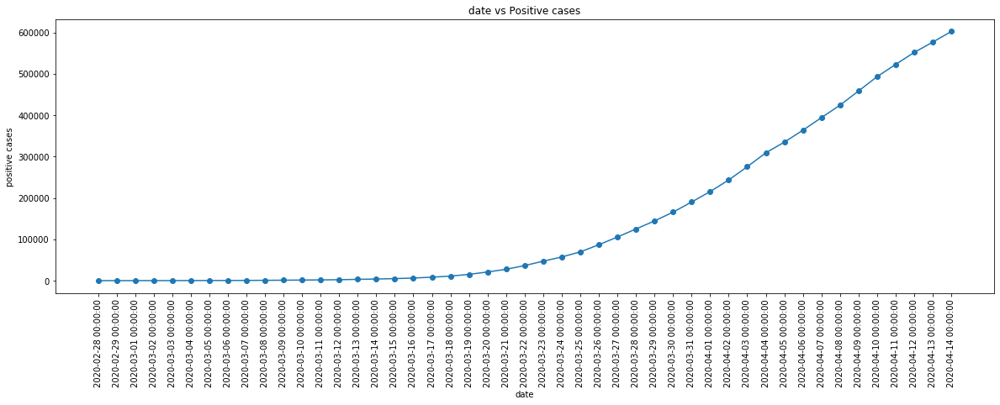

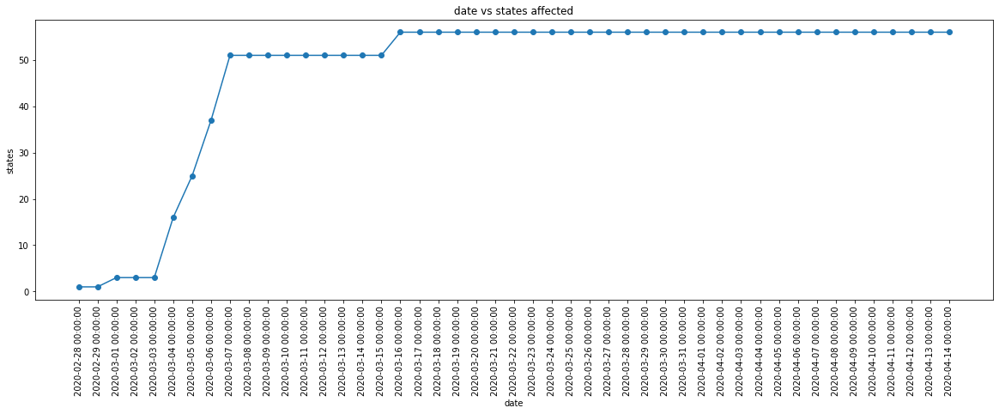

In [38]:

TimeseriesCovidAffectedStates()




<h2 id="preprocessing-of-data-to-generate-the-result-of-dependency-in-spread-of-covid19-cases--due-to-flights-from-one-place-to-another-in-USA">preprocessing of data to generate the result of dependency in spread of covid19 cases  due to flights from one place to another in USA<a class="anchor-link" href="#preprocessing-of-data-to-generate-the-result-of-dependency-in-spread-of-covid19-cases--due-to-flights-from-one-place-to-another-in-USA">¶</a></h2>


In [39]:

# Function name : getState()
# Parameters    : airport(code of airport)
# Description   : It will return the state corresponding to the airport in which it is present.

def getState(airport):
    statesCode1 = pd.read_csv('data/AMStates.csv',skipinitialspace=True, usecols=['OCcode','Origin_airport'])
    statesCode2 = pd.read_csv('data/AMStates.csv',skipinitialspace=True, usecols=['Dccode','Destination_airport'])

    SC1 = statesCode1.values.tolist()
    SC2 = statesCode2.values.tolist()

    SC  = SC1+SC2

    tp = np.unique(SC, axis=0)
    unq = [] 
    for index in tp:
        unq.append(tuple(index))
    
    for i in unq:
        if(i[0]==airport):
            return i[1]
    



In [40]:

# Function name : getAirport()
# Parameters    : stateCode
# Description   : It will return the airport corresponding to the state in which it is present.

def getAirport(stateCode):
    statesCode1 = pd.read_csv('data/AMStates.csv',skipinitialspace=True, usecols=['OCcode','Origin_airport'])
    statesCode2 = pd.read_csv('data/AMStates.csv',skipinitialspace=True, usecols=['Dccode','Destination_airport'])

    SC1 = statesCode1.values.tolist()
    SC2 = statesCode2.values.tolist()

    SC  = SC1+SC2

    tp = np.unique(SC, axis=0)
    unq = [] 
    for index in tp:
        unq.append(tuple(index))
    
    for i in unq:
        if(i[1]==stateCode):
            return i[0]



In [41]:

covid19 = pd.read_csv('data/covidfinal.csv',skipinitialspace=True, usecols=['state','positive'])
covid19 = covid19.values.tolist()

# Function name : FindDependency()
# Parameters    : path(list of airorts that connects through flights),low,high(index bounds)
# Description   : It finds the dependency on the basis of movement of passengers from src to dest.
#                 First, it gets the state of source and dest.
#                 second,it maps the value of positive corona cases in that state with state nodes
#                 after the mapping, it applies the algo to get the dependency factor and compare it with the threshold.
#                 Threshold was decided by comparing the time series data in the USA
#                 This algo not only comment on the dependency of src and dest airport that are directly connected.
#                 It also determines the dependency if there are intermediate nodes in between the src and dest.


def FindDependency(path,low,high):
    
    length = high-low;
    
    Threshold = 0.1
    for i in range(low,high):
        
        stateofAirport1 = getState(path[i])
        stateofAirport2 = getState(path[i+1])
        print(stateofAirport1,stateofAirport2," (source airport state, Destination airport state)")
        print(path[i],path[i+1]," (source airport, Destination airport)")
    
        SrcCases = 0
        for nd in covid19:
            if(nd[0]==stateofAirport1):
                SrcCases = nd[1]
                break
        for ndd in covid19:
            if(ndd[0]==stateofAirport2):
                DestCases = ndd[1]
                break
        val = graph[path[i]][path[i+1]]['Flights']
        print("number of positive cases at source state",SrcCases)
        print("number of positive cases at destination state",DestCases)
        print("Dependency factor: "+"{:.2f}".format((SrcCases/(val*200*4))))
        if((SrcCases/(val*200*4)) < Threshold and DestCases > 250):
            return False
    return True




<h1 id="Predicting-dependency-of-spread-of-covid19-cases-from-the-movement-of-flights-from-one-place-to-another">Predicting dependency of spread of covid19 cases from the movement of flights from one place to another<a class="anchor-link" href="#Finding-dependency-of-spread-of-covid19-cases-from-the-movement-of-flights-from-one-place-to-another">¶</a></h1>


In [42]:

# Function name : FindCovidDependency()
# Parameters    : graph(airport network graph),low,high(index bounds)
# Description   : It is a calling function for the FindDependency Function.
#                 It computes the path between the src and dest airports and plot their connectivity on USA terrain.
#                 Finally it calls the FindDependency to get the bool value from it.

def FindCovidDependency(graph,src,dest):
    
    print()
    path = nx.astar_path(graph, src, dest)
    print(path)
    length = len(path)-1   
    ShowShortestPath(path)
    val = FindDependency(path,0,length)
    
    print("Result:")
    print()
    if(val==True):
        print("YES, Movement of passengers from "+src+" to "+dest+" by flights might responsible in spread of Covid19 cases")
    else:
        print("NO, Movement of passengers from "+src+" to "+dest+" by flights has not responsible in spread of Covid19 cases. If cases are there, it is due to rapid internal spread at that state or by local transport")




['ADQ', 'ANC', 'MIA', 'APF']


/home/anuj/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:35: MatplotlibDeprecationWarning: 
The dedent function was deprecated in Matplotlib 3.1 and will be removed in 3.3. Use inspect.cleandoc instead.
/home/anuj/anaconda3/lib/python3.7/site-packages/networkx/drawing/nx_pylab.py:579: MatplotlibDeprecationWarning: 
The iterable function was deprecated in Matplotlib 3.1 and will be removed in 3.3. Use np.iterable instead.
  if not cb.iterable(width):
/home/anuj/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:54: MatplotlibDeprecationWarning: 
The dedent function was deprecated in Matplotlib 3.1 and will be removed in 3.3. Use inspect.cleandoc instead.
/home/anuj/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: 
The dedent function was deprecated in Matplotlib 3.1 and will be removed in 3.3. Use inspect.cleandoc instead.


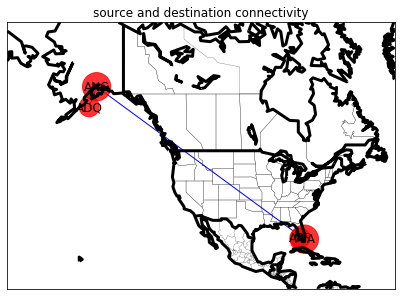

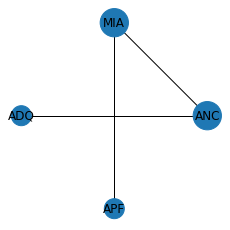

AK AK  (source airport state, Destination airport state)
ADQ ANC  (source airport, Destination airport)
number of positive cases at source state 285
number of positive cases at destination state 285
Dependency factor: 0.06
Result:

NO, Movement of passengers from ADQ to APF by flights has not responsible in spread of Covid19 cases. If cases are there, it is due to rapid internal spread at that state or by local transport


In [43]:

FindCovidDependency(graph,"ADQ","APF")




['SHR', 'EKO', 'SUX']


/home/anuj/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:35: MatplotlibDeprecationWarning: 
The dedent function was deprecated in Matplotlib 3.1 and will be removed in 3.3. Use inspect.cleandoc instead.
/home/anuj/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:54: MatplotlibDeprecationWarning: 
The dedent function was deprecated in Matplotlib 3.1 and will be removed in 3.3. Use inspect.cleandoc instead.
/home/anuj/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:55: MatplotlibDeprecationWarning: 
The dedent function was deprecated in Matplotlib 3.1 and will be removed in 3.3. Use inspect.cleandoc instead.


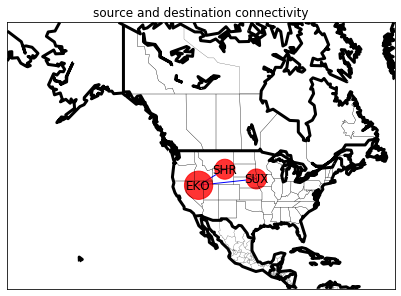

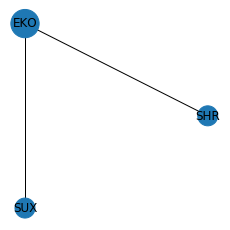

WY NV  (source airport state, Destination airport state)
SHR EKO  (source airport, Destination airport)
number of positive cases at source state 275
number of positive cases at destination state 3088
Dependency factor: 0.34
NV IA  (source airport state, Destination airport state)
EKO SUX  (source airport, Destination airport)
number of positive cases at source state 3088
number of positive cases at destination state 1899
Dependency factor: 3.86
Result:

YES, Movement of passengers from SHR to SUX by flights might responsible in spread of Covid19 cases


In [44]:

FindCovidDependency(graph,"SHR","SUX")



In [45]:

print(getAirport("CA"))



ACV


In [46]:

# Function name : printStates()
# Parameters    : None
# Description   : It prints the all the states present in state network.

def printStates():  
    listStates = []
    for i in covid19:
        listStates.append(i[0])
    print(listStates)



In [47]:

printStates()



['AK', 'AL', 'AR', 'AZ', 'CA', 'CO', 'CT', 'DC', 'DE', 'FL', 'GA', 'HI', 'IA', 'ID', 'IL', 'IN', 'KS', 'KY', 'LA', 'MA', 'MD', 'ME', 'MI', 'MN', 'MO', 'MS', 'MT', 'NC', 'ND', 'NE', 'NH', 'NJ', 'NM', 'NV', 'NY', 'OH', 'OK', 'OR', 'PA', 'RI', 'SC', 'SD', 'TN', 'TX', 'UT', 'VA', 'VT', 'WA', 'WI', 'WV', 'WY']


In [48]:

ShowAirportsList()



List of airports are:

['ITO', 'ORL', 'MHR', 'FSM', 'PNC', 'SVN', 'GFK', 'PBF', 'TTN', 'BOS', 'BFM', 'OAK', 'OMA', 'OGG', 'ICT', 'MCI', 'MSN', 'HRO', 'PHX', 'BGR', 'FXE', 'GGG', 'AND', 'GEG', 'SFO', 'ARA', 'GNV', 'MEM', 'CNW', 'POB', 'DLF', 'LAX', 'ANB', 'CLE', 'DOV', 'CVG', 'HON', 'JNU', 'LFT', 'EWR', 'GCK', 'MOT', 'MXF', 'DAL', 'HLN', 'NKX', 'LUF', 'END', 'LCH', 'MYR', 'DCA', 'BYH', 'ACY', 'TIK', 'PUB', 'GRF', 'ADQ', 'FLL', 'SLC', 'LSF', 'MDT', 'LNK', 'LAN', 'HKY', 'IAH', 'BFL', 'ELP', 'CAE', 'DMA', 'NPA', 'PNS', 'HOU', 'PIT', 'EFD', 'VAD', 'MIA', 'SEA', 'CHA', 'BDR', 'JAN', 'IPT', 'IND', 'SZL', 'GWO', 'JBR', 'NZY', 'BIF', 'YUM', 'CNM', 'DLH', 'HUF', 'HVR', 'MWH', 'RIC', 'SHV', 'BPT', 'SAV', 'HIF', 'SAT', 'ROC', 'RCA', 'RDU', 'DAY', 'ESF', 'LTS', 'TUS', 'MIB', 'GSB', 'PVD', 'SBY', 'DTW', 'TPA', 'EIL', 'MAF', 'GRB', 'ADM', 'AGS', 'ISN', 'LIT', 'SAC', 'TBN', 'SKA', 'PAM', 'DFW', 'TCM', 'AUS', 'LCK', 'MQT', 'TYS', 'STL', 'SPS', 'LUK', 'ATL', 'MCC', 'GRR', 'FAT', 'IPL', 'BNA', 'LRD', 'ED